<a href="https://colab.research.google.com/github/Candida18/ADS_SMA/blob/main/5.%20Content%20based%20SMA%20model%20for%20business%20(Union_Budget_Twitter_Analysis).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### <b>Name: Candida Noronha<br/>
### <b>Class: BE COMPS B<br/>
### <b>Roll No.: 8960
### <b>Experiment 5 - Union Budget Twitter Analysis

In [ ]:
!pip install snscrape

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pandas as pd
import snscrape.modules.twitter as sntwitter
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
nltk.download('stopwords')

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.stem.porter import PorterStemmer

import string
import re
import textblob
from textblob import TextBlob
import os

from wordcloud import WordCloud, STOPWORDS
from wordcloud import ImageColorGenerator
import warnings
%matplotlib inline

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
os.system("snscrape --jsonl --max-results 5000 --since 2023-01-31 twitter-search 'Budget 2023 until:2023-02-07'>text-query-tweets.json")

0

In [ ]:
tweets_df = pd.read_json("text-query-tweets.json" ,lines=True)

In [ ]:
tweets_df.head(5)

,_type,url,date,rawContent,renderedContent,id,user,replyCount,retweetCount,likeCount,...,cashtags,card,viewCount,vibe,content,outlinks,outlinksss,tcooutlinks,tcooutlinksss,username
0,snscrape.modules.twitter.Tweet,https://twitter.com/Econnol333/status/16227469...,2023-02-06 23:59:56+00:00,Biden....your budget is due today.\n#budget\n#...,Biden....your budget is due today.\n#budget\n#...,1622746949555462144,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,...,None,None,11.0,NaN,Biden....your budget is due today.\n#budget\n#...,[],,[],,Econnol333
1,snscrape.modules.twitter.Tweet,https://twitter.com/hillsboro_sd/status/162274...,2023-02-06 23:57:38+00:00,Governor’s 2023-25 Budget Proposal\nhttps://t....,Governor’s 2023-25 Budget Proposal\nbit.ly/3DL...,1622746372280848385,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,...,None,None,100.0,NaN,Governor’s 2023-25 Budget Proposal\nhttps://t....,"[https://bit.ly/3DLJ61J, https://bit.ly/3DLJ61J]",https://bit.ly/3DLJ61J https://bit.ly/3DLJ61J,"[https://t.co/2sIZ8XGK1N, https://t.co/2sIZ8XG...",https://t.co/2sIZ8XGK1N https://t.co/2sIZ8XGK1N,hillsboro_sd
2,snscrape.modules.twitter.Tweet,https://twitter.com/cityofcolwood/status/16227...,2023-02-06 23:56:40+00:00,Have you been following #Colwood Council budge...,Have you been following #Colwood Council budge...,1622746125236314112,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,1,1,...,None,None,300.0,NaN,Have you been following #Colwood Council budge...,[http://www.colwood.ca/Budget],http://www.colwood.ca/Budget,[https://t.co/4sgMiVkSzN],https://t.co/4sgMiVkSzN,cityofcolwood
3,snscrape.modules.twitter.Tweet,https://twitter.com/walterrobinson/status/1622...,2023-02-06 23:56:19+00:00,Will @CanadianPM @JustinTrudeau and his https:...,Will @CanadianPM @JustinTrudeau and his canada...,1622746040423030787,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,3,...,None,None,76.0,NaN,Will @CanadianPM @JustinTrudeau and his https:...,"[http://canadaspremiers.ca, https://diabetes.c...",http://canadaspremiers.ca https://diabetes.ca/...,"[https://t.co/qdO4dpiYov, https://t.co/tgphEiq...",https://t.co/qdO4dpiYov https://t.co/tgphEiqDYD,walterrobinson
4,snscrape.modules.twitter.Tweet,https://twitter.com/beupdatedxyz/status/162274...,2023-02-06 23:54:09+00:00,15 Best Automatic Watches for Every Style and ...,15 Best Automatic Watches for Every Style and ...,1622745493628411904,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,...,None,None,NaN,NaN,15 Best Automatic Watches for Every Style and ...,[https://beupdated.xyz/2023/02/06/15-best-auto...,https://beupdated.xyz/2023/02/06/15-best-autom...,[https://t.co/G9E5zNFJ96],https://t.co/G9E5zNFJ96,beupdatedxyz


In [ ]:
tweets_df.to_csv()

',_type,url,date,rawContent,renderedContent,id,user,replyCount,retweetCount,likeCount,quoteCount,conversationId,lang,source,sourceUrl,sourceLabel,links,media,retweetedTweet,quotedTweet,inReplyToTweetId,inReplyToUser,mentionedUsers,coordinates,place,hashtags,cashtags,card,viewCount,vibe,content,outlinks,outlinksss,tcooutlinks,tcooutlinksss,username\n0,snscrape.modules.twitter.Tweet,https://twitter.com/Econnol333/status/1622746949555462144,2023-02-06 23:59:56+00:00,"Biden....your budget is due today.\n#budget\n#Budget2023","Biden....your budget is due today.\n#budget\n#Budget2023",1622746949555462144,"{\'_type\': \'snscrape.modules.twitter.User\', \'username\': \'Econnol333\', \'id\': 1511194022575939585, \'displayname\': \'Econnol\', \'rawDescription\': \'how many conspiracy theories have been proved to be correct? #fauciLied  public schools have become grooming indoctrination centers #homeschool #schoolVouchers\', \'renderedDescription\': \'how many conspiracy theories have been proved

In [ ]:
df1 = tweets_df[[ 'date', 'rawContent' , 'renderedContent' , 'user' , 'replyCount' ,'retweetCount' , 'likeCount' , 'lang' , 'place' , 'hashtags' , 'viewCount']].copy()

In [ ]:
df1.head()

,date,rawContent,renderedContent,user,replyCount,retweetCount,likeCount,lang,place,hashtags,viewCount
0,2023-02-06 23:59:56+00:00,Biden....your budget is due today.\n#budget\n#...,Biden....your budget is due today.\n#budget\n#...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,"[budget, Budget2023]",11.0
1,2023-02-06 23:57:38+00:00,Governor’s 2023-25 Budget Proposal\nhttps://t....,Governor’s 2023-25 Budget Proposal\nbit.ly/3DL...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,es,None,None,100.0
2,2023-02-06 23:56:40+00:00,Have you been following #Colwood Council budge...,Have you been following #Colwood Council budge...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,1,1,en,None,[Colwood],300.0
3,2023-02-06 23:56:19+00:00,Will @CanadianPM @JustinTrudeau and his https:...,Will @CanadianPM @JustinTrudeau and his canada...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,3,en,None,"[FundTheFramework, diabetes, Budget2023, cdnpo...",76.0
4,2023-02-06 23:54:09+00:00,15 Best Automatic Watches for Every Style and ...,15 Best Automatic Watches for Every Style and ...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,None,NaN


In [ ]:
df1.shape

(5000, 11)

In [ ]:
df1=df1.drop_duplicates("renderedContent")

In [ ]:
df1.shape

(4797, 11)

In [ ]:
df1.head

<bound method NDFrame.head of                           date  \
0    2023-02-06 23:59:56+00:00   
1    2023-02-06 23:57:38+00:00   
2    2023-02-06 23:56:40+00:00   
3    2023-02-06 23:56:19+00:00   
4    2023-02-06 23:54:09+00:00   
...                        ...   
4995 2023-02-05 04:45:44+00:00   
4996 2023-02-05 04:45:28+00:00   
4997 2023-02-05 04:45:16+00:00   
4998 2023-02-05 04:45:00+00:00   
4999 2023-02-05 04:45:00+00:00   

                                             rawContent  \
0     Biden....your budget is due today.\n#budget\n#...   
1     Governor’s 2023-25 Budget Proposal\nhttps://t....   
2     Have you been following #Colwood Council budge...   
3     Will @CanadianPM @JustinTrudeau and his https:...   
4     15 Best Automatic Watches for Every Style and ...   
...                                                 ...   
4995  केंद्रीय स्वास्थ्य मंत्री डॉ मनसुख ने गुरुग्रा...   
4996  @raosahebdanve जानिए कैसे #Budget2023 के प्राव...   
4997  आज गुरुग्राम में #Budget

In [ ]:
df1.info

<bound method DataFrame.info of                           date  \
0    2023-02-06 23:59:56+00:00   
1    2023-02-06 23:57:38+00:00   
2    2023-02-06 23:56:40+00:00   
3    2023-02-06 23:56:19+00:00   
4    2023-02-06 23:54:09+00:00   
...                        ...   
4995 2023-02-05 04:45:44+00:00   
4996 2023-02-05 04:45:28+00:00   
4997 2023-02-05 04:45:16+00:00   
4998 2023-02-05 04:45:00+00:00   
4999 2023-02-05 04:45:00+00:00   

                                             rawContent  \
0     Biden....your budget is due today.\n#budget\n#...   
1     Governor’s 2023-25 Budget Proposal\nhttps://t....   
2     Have you been following #Colwood Council budge...   
3     Will @CanadianPM @JustinTrudeau and his https:...   
4     15 Best Automatic Watches for Every Style and ...   
...                                                 ...   
4995  केंद्रीय स्वास्थ्य मंत्री डॉ मनसुख ने गुरुग्रा...   
4996  @raosahebdanve जानिए कैसे #Budget2023 के प्राव...   
4997  आज गुरुग्राम में #Budg

In [ ]:
df1.date.value_counts()

2023-02-05 06:30:00+00:00    7
2023-02-06 12:01:49+00:00    5
2023-02-05 08:30:00+00:00    5
2023-02-06 08:19:28+00:00    4
2023-02-06 06:44:18+00:00    3
                            ..
2023-02-06 10:14:22+00:00    1
2023-02-06 10:14:07+00:00    1
2023-02-06 10:14:02+00:00    1
2023-02-06 10:14:01+00:00    1
2023-02-06 06:54:14+00:00    1
Name: date, Length: 4611, dtype: int64

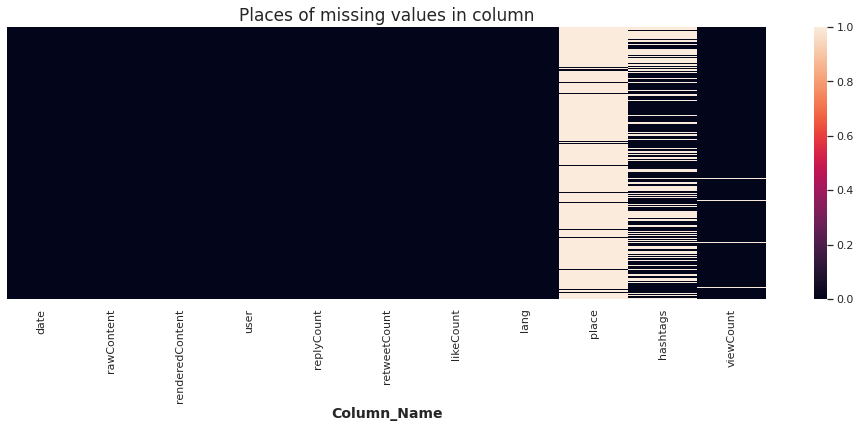

In [ ]:
plt.figure(figsize=(17, 5))
sns.heatmap(df1.isnull(), cbar=True, yticklabels=False)
plt.xlabel("Column_Name", size=14, weight="bold")
plt.title("Places of missing values in column",size=17)
plt.show()

In [ ]:
import plotly.graph_objects as go
Top_Location_Of_tweet= df1['place'].value_counts().head (10)

In [ ]:
print(Top_Location_Of_tweet)

{'_type': 'snscrape.modules.twitter.Place', 'id': '317fcc4b21a604d5', 'fullName': 'New Delhi, India', 'name': 'New Delhi', 'type': 'city', 'country': 'India', 'countryCode': 'IN'}                13
{'_type': 'snscrape.modules.twitter.Place', 'id': '8a927a7056322151', 'fullName': 'Botswana', 'name': 'Botswana', 'type': 'country', 'country': 'Botswana', 'countryCode': 'BW'}                   10
{'_type': 'snscrape.modules.twitter.Place', 'id': '7929cea6bd5b32bd', 'fullName': 'Mumbai, India', 'name': 'Mumbai', 'type': 'city', 'country': 'India', 'countryCode': 'IN'}                       6
{'_type': 'snscrape.modules.twitter.Place', 'id': '3e61c40254ccb127', 'fullName': 'Nanded, India', 'name': 'Nanded', 'type': 'city', 'country': 'India', 'countryCode': 'IN'}                       5
{'_type': 'snscrape.modules.twitter.Place', 'id': 'b850c1bfd38f30e0', 'fullName': 'India', 'name': 'India', 'type': 'country', 'country': 'India', 'countryCode': 'IN'}                             5
{'_type': 

In [ ]:
from nltk. corpus import stopwords
stop = stopwords.words('english')
df1['renderedContent'].apply(lambda x: [item for item in x if item not in stop])
df1.shape

(4797, 11)

In [ ]:
!pip install tweet-preprocessor

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#Remove unnecessary characters
punct  =  ['%','/',':','\\','&amp','&',';','?']

def remove_punctuations(text):
  for punctuation in punct:
    text = text.replace(punctuation,'')
  return text

In [ ]:
df1['renderedContent'] = df1['renderedContent'].apply(lambda x: remove_punctuations(x))

In [ ]:
df1['renderedContent'].replace( '', np.nan, inplace=True)
df1.dropna(subset=["renderedContent"],inplace=True)
len(df1)

4797

In [ ]:
df1 = df1.reset_index(drop=True)
df1.head()

,date,rawContent,renderedContent,user,replyCount,retweetCount,likeCount,lang,place,hashtags,viewCount
0,2023-02-06 23:59:56+00:00,Biden....your budget is due today.\n#budget\n#...,Biden....your budget is due today.\n#budget\n#...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,"[budget, Budget2023]",11.0
1,2023-02-06 23:57:38+00:00,Governor’s 2023-25 Budget Proposal\nhttps://t....,Governor’s 2023-25 Budget Proposal\nbit.ly3DLJ...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,es,None,None,100.0
2,2023-02-06 23:56:40+00:00,Have you been following #Colwood Council budge...,Have you been following #Colwood Council budge...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,1,1,en,None,[Colwood],300.0
3,2023-02-06 23:56:19+00:00,Will @CanadianPM @JustinTrudeau and his https:...,Will @CanadianPM @JustinTrudeau and his canada...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,3,en,None,"[FundTheFramework, diabetes, Budget2023, cdnpo...",76.0
4,2023-02-06 23:54:09+00:00,15 Best Automatic Watches for Every Style and ...,15 Best Automatic Watches for Every Style and ...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,None,NaN


In [ ]:
from sklearn.feature_extraction. text import TfidfVectorizer, CountVectorizer

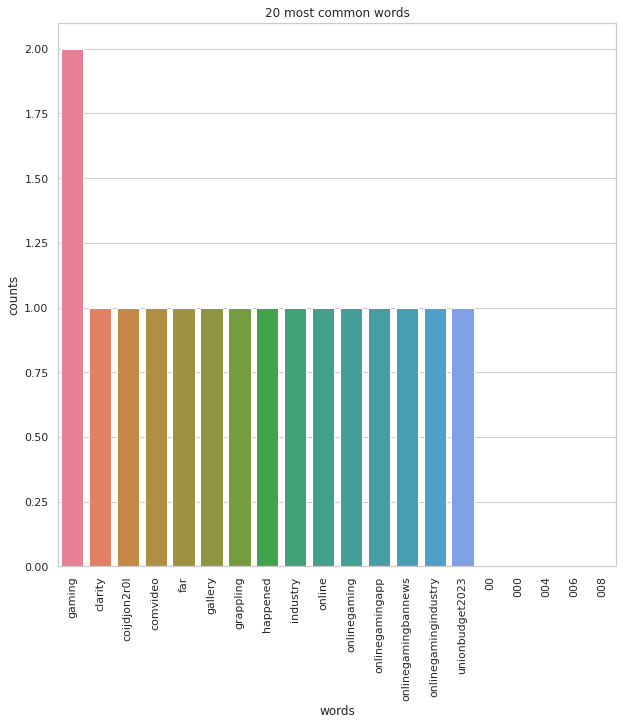

<Figure size 432x288 with 0 Axes>

In [ ]:
sns.set_style('whitegrid')
%matplotlib inline
stop=stop+['budget2023' , 'budget' , 'httpst' , '2023', 'modi' ,'nsitaraman' , 'union', 'pmindia' , 'tax' , 'india']
def plot_20_most_common_words(count_data, count_vectorizer) :
  import matplotlib. pyplot as plt
  words = count_vectorizer.get_feature_names_out()
  total_counts = np. zeros(len(words))
  for t in count_data:
    total_counts = t.toarray()[0]

  count_dict = (zip(words, total_counts))
  count_dict = sorted(count_dict, key=lambda x:x[1],reverse=True)[0:20]
  words = [w[0] for w in count_dict]
  counts = [w[1] for w in count_dict]
  x_pos = np.arange(len(words))

  plt.figure(2,(10,10))
  plt.subplot(title = '20 most common words')
  # sns.set_context('notebook',font_scale=1,rc={ 'lines.linewidth' :0.5})
  sns.barplot(x=x_pos, y=counts, palette='husl')
  plt.xticks(x_pos, words, rotation=90)
  plt.xlabel('words')
  plt.ylabel('counts')
  plt.show()

count_vectorizer = CountVectorizer(stop_words=stop)
# Fit and transform the processed titles
count_data = count_vectorizer.fit_transform(df1['renderedContent'])
# print(count_vectorizer)
# print(count_data)
# Visualise the 20 most common words
plot_20_most_common_words(count_data,count_vectorizer)
plt.savefig( 'saved_figure.png')

<Axes: title={'center': 'Top 8 bigrams'}, ylabel='ngram'>

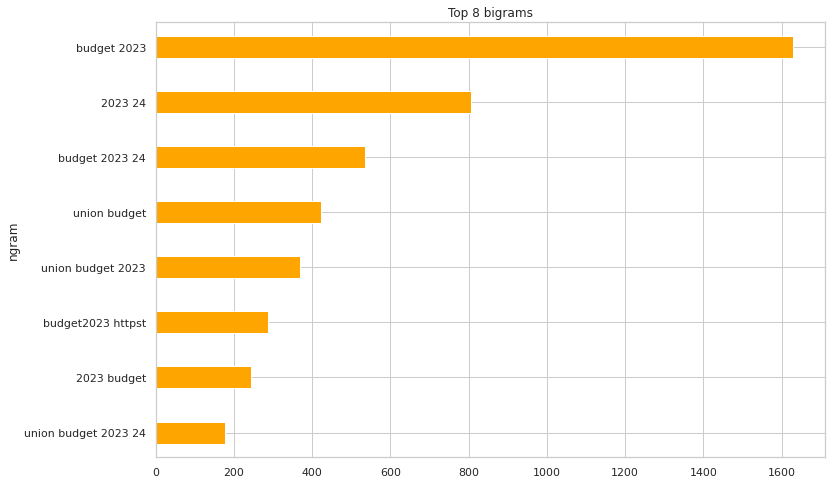

In [ ]:
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

def get_top_n_bigram(corpus, n=None) :
  vec = CountVectorizer(ngram_range=(2, 4), stop_words="english").fit(corpus)
  bag_of_words = vec.transform(corpus)
  sum_words = bag_of_words.sum(axis=0)
  words_freq =[(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
  words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
  return words_freq[:n]

common_words = get_top_n_bigram(df1['renderedContent'] , 8)
mydict={}
for word, freq in common_words:
  bigram_df = pd.DataFrame(common_words,columns = ['ngram', 'count'])

bigram_df.groupby( 'ngram' ).sum()['count'].sort_values(ascending=False).sort_values().plot.barh(title = 'Top 8 bigrams',color='orange' , width=.4, figsize=(12,8),stacked = True)

In [ ]:
def get_subjectivity(text):
  return TextBlob(text).sentiment.subjectivity
def get_polarity(text):
  return TextBlob(text).sentiment.polarity

In [ ]:
df1['subjectivity']=df1[ 'renderedContent'].apply(get_subjectivity)
df1[ 'polarity' ]=df1[ 'renderedContent'].apply(get_polarity)
df1.head()

,date,rawContent,renderedContent,user,replyCount,retweetCount,likeCount,lang,place,hashtags,viewCount,subjectivity,polarity
0,2023-02-06 23:59:56+00:00,Biden....your budget is due today.\n#budget\n#...,Biden....your budget is due today.\n#budget\n#...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,"[budget, Budget2023]",11.0,0.375000,-0.125000
1,2023-02-06 23:57:38+00:00,Governor’s 2023-25 Budget Proposal\nhttps://t....,Governor’s 2023-25 Budget Proposal\nbit.ly3DLJ...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,es,None,None,100.0,0.000000,0.000000
2,2023-02-06 23:56:40+00:00,Have you been following #Colwood Council budge...,Have you been following #Colwood Council budge...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,1,1,en,None,[Colwood],300.0,0.208333,0.041667
3,2023-02-06 23:56:19+00:00,Will @CanadianPM @JustinTrudeau and his https:...,Will @CanadianPM @JustinTrudeau and his canada...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,3,en,None,"[FundTheFramework, diabetes, Budget2023, cdnpo...",76.0,0.100000,0.000000
4,2023-02-06 23:54:09+00:00,15 Best Automatic Watches for Every Style and ...,15 Best Automatic Watches for Every Style and ...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,None,NaN,0.300000,1.000000


In [ ]:
df1['textblob_score'] =df1[ 'renderedContent'].apply(lambda x: TextBlob(x).sentiment.polarity)

In [ ]:
neutral_threshold=0.05

In [ ]:

df1['textblob_sentiment']=df1[ 'textblob_score'].apply(lambda c:'positive' if c >= neutral_threshold else ('Negative' if c <= -(neutral_threshold) else 'Neutral' ) )

In [ ]:
textblob_df =  df1[['renderedContent','textblob_sentiment','likeCount']]
textblob_df

,renderedContent,textblob_sentiment,likeCount
0,Biden....your budget is due today.\n#budget\n#...,Negative,0
1,Governor’s 2023-25 Budget Proposal\nbit.ly3DLJ...,Neutral,0
2,Have you been following #Colwood Council budge...,Neutral,1
3,Will @CanadianPM @JustinTrudeau and his canada...,Neutral,3
4,15 Best Automatic Watches for Every Style and ...,positive,0
...,...,...,...
4792,केंद्रीय स्वास्थ्य मंत्री डॉ मनसुख ने गुरुग्रा...,Neutral,3
4793,@raosahebdanve जानिए कैसे #Budget2023 के प्राव...,Neutral,0
4794,आज गुरुग्राम में #Budget2023 पर चर्चा कार्यक्र...,Neutral,1
4795,#BudgetWithCNBCTV18 | What’s getting cheaper W...,positive,6


In [ ]:
textblob_df["textblob_sentiment"].value_counts()

Neutral     2858
positive    1516
Negative     423
Name: textblob_sentiment, dtype: int64

<Axes: title={'center': 'Sentiment Analysis'}>

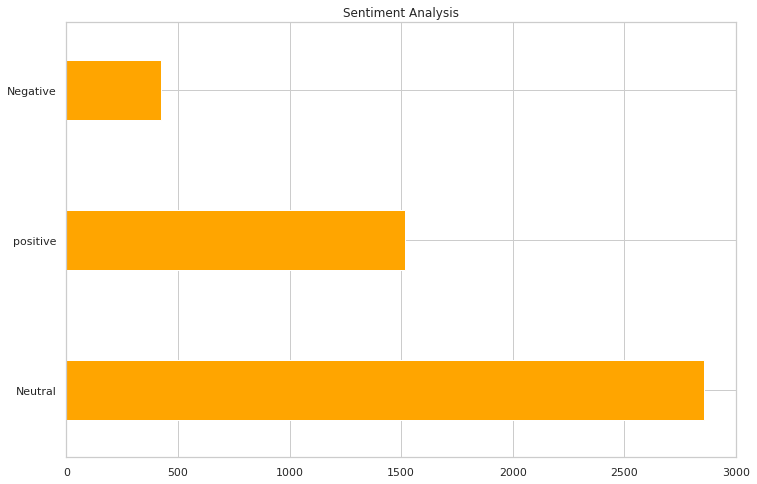

In [ ]:
textblob_df["textblob_sentiment"].value_counts().plot.barh(title = 'Sentiment Analysis',color='orange' , width=.4, figsize=(12,8),stacked = True)

In [ ]:
df_positive=textblob_df[textblob_df['textblob_sentiment']=='positive' ]

In [ ]:
df_very_positive=df_positive[df_positive['likeCount']>0]

In [ ]:
df_very_positive.head()

,renderedContent,textblob_sentiment,likeCount
5,@HStefansonMB @fordnation @RanjPillai1 Let's r...,positive,1
6,@LeagueOfLegends Biggest budget and transparen...,positive,1
15,By investing in affordable reliable #internet...,positive,1
20,Where you live should not determine whether yo...,positive,1
38,RAP Stage II\n• Applications are now invited f...,positive,1


In [ ]:
df_negative=textblob_df[textblob_df['textblob_sentiment']=='Negative' ]

In [ ]:
df_negative

,renderedContent,textblob_sentiment,likeCount
0,Biden....your budget is due today.\n#budget\n#...,Negative,0
28,Union Budget 2023 Middle-class thrust that lar...,Negative,0
36,@GovBillLee #WelfareState \n2022-2023 TENNESSE...,Negative,0
42,$70 per barrel for Urals. The current price is...,Negative,15
43,#Russia_Sanctions Some bad news on oil revenue...,Negative,47
...,...,...,...
4756,Why did the budget cross the road To get to th...,Negative,1
4765,The Union Budget FY 2023-24 Vision 'Amrit Kaal...,Negative,15
4775,Budget gives middle class a little relief.\n#g...,Negative,0
4782,"""The Budget shows how far this government is r...",Negative,17


In [ ]:
df_neutral=textblob_df[textblob_df['textblob_sentiment']=='Neutral' ]

In [ ]:
df_neutral

,renderedContent,textblob_sentiment,likeCount
1,Governor’s 2023-25 Budget Proposal\nbit.ly3DLJ...,Neutral,0
2,Have you been following #Colwood Council budge...,Neutral,1
3,Will @CanadianPM @JustinTrudeau and his canada...,Neutral,3
9,"This evening, our President CEO, @gregorydunn...",Neutral,7
13,Ukraine Invasion Russia has been selling forei...,Neutral,0
...,...,...,...
4788,Chandra Raj Singhvi analyzed the budget !! #Sh...,Neutral,0
4790,बजट के ऊपर चर्चा करने के बाद प्रेस कॉन्फ्रेंस ...,Neutral,2
4792,केंद्रीय स्वास्थ्य मंत्री डॉ मनसुख ने गुरुग्रा...,Neutral,3
4793,@raosahebdanve जानिए कैसे #Budget2023 के प्राव...,Neutral,0


In [ ]:
from wordcloud import WordCloud, STOPWORDS
from PIL import Image

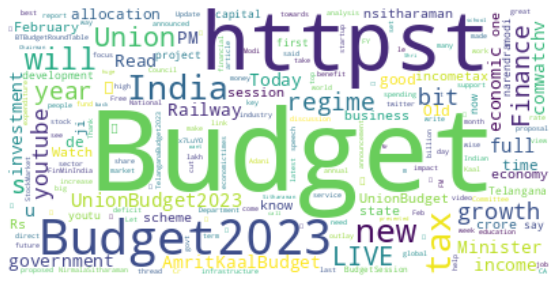

In [ ]:
#Creating the text variable
positive_tw =" ".join(t for t in df_very_positive.renderedContent)
# Creating word _ cloud with text as argument in . generate() rtpthod
word_cloud1 = WordCloud(collocations = False, background_color = 'white') .generate(positive_tw)
# Display the generated Word Cloud
plt.figure(figsize=(17, 5))
plt. imshow(word_cloud1, interpolation='bilinear')
plt.axis('off')

plt.show()

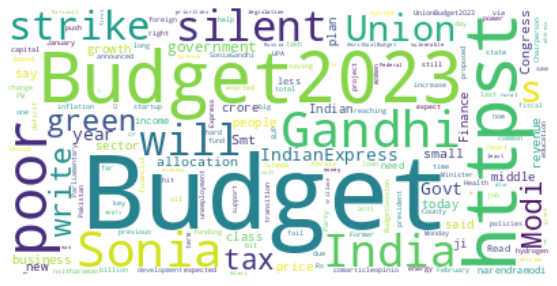

In [ ]:
#Creating the text variable
positive_tw =" ".join(t for t in df_negative.renderedContent)
# Creating word _ cloud with text as argument in . generate() rtpthod
word_cloud1 = WordCloud(collocations = False, background_color = 'white') .generate(positive_tw)
# Display the generated Word Cloud
plt.figure(figsize=(17, 5))
plt. imshow(word_cloud1, interpolation='bilinear')
plt.axis('off')

plt.show()

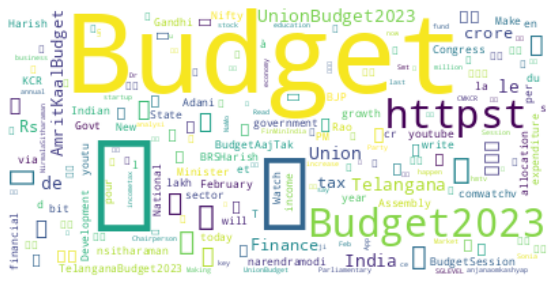

In [ ]:
#Creating the text variable
neutral_tw =" ".join(t for t in df_neutral.renderedContent)
# Creating word _ cloud with text as argument in . generate() rtpthod
word_cloud2 = WordCloud(collocations = False, background_color = 'white') .generate(neutral_tw)
# Display the generated Word Cloud
plt.figure(figsize=(17, 5))
plt. imshow(word_cloud2, interpolation='bilinear')
plt.axis('off')
plt.show()